In [1]:
# Helper function, used these for debugging purposes
# detector2 build only succeeds if CUDA version is correct

!nvidia-smi
!nvcc --version

import torch
torch.__version__
import torchvision
torchvision.__version__

#!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.7/index.html
!pip install 'git+https://github.com/facebookresearch/detectron2.git'

Thu Feb 20 03:39:29 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla P100-PCIE-16GB           Off |   00000000:00:04.0 Off |                    0 |
| N/A   32C    P0             26W /  250W |       0MiB /  16384MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
# Base setup:
# detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# common libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
%matplotlib inline

# detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

In [3]:
import os
import json
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode

# Define the dataset paths
TRAIN_PATH = '/kaggle/input/solarpv-dataset/train'
TEST_PATH = '/kaggle/input/solarpv-dataset/test'
VALID_PATH = '/kaggle/input/solarpv-dataset/valid'

def get_solar_panel_dicts(dataset_dict):
    """
    Convert processed dataset to Detectron2 format
    """
    detectron2_annotations = []
    
    for image in dataset_dict['images']:
        record = {}
        
        # Get image info
        record["file_name"] = image['file_name']
        record["height"] = image['height']
        record["width"] = image['width']
        record["image_id"] = image['id']
        
        # Get annotations for this image
        annos = []
        for anno in dataset_dict['annotations']:
            if anno['image_id'] == image['id']:
                obj = {
                    "bbox": anno['bbox'],
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "segmentation": anno['segmentation'],
                    "category_id": anno['category_id'],
                    "iscrowd": anno.get('iscrowd', 0)
                }
                annos.append(obj)
        
        record["annotations"] = annos
        detectron2_annotations.append(record)
    
    return detectron2_annotations

def process_dataset(annotations, images_path):
    dataset = {
        'images': [],
        'annotations': annotations['annotations'],
        'categories': annotations['categories']
    }
    
    for img in annotations['images']:
        img['file_name'] = os.path.join(images_path, img['file_name'])
        dataset['images'].append(img)
    
    return dataset

# Load and process the datasets
train_annotations = json.load(open(os.path.join(TRAIN_PATH, '_annotations.coco.json')))
test_annotations = json.load(open(os.path.join(TEST_PATH, '_annotations.coco.json')))
valid_annotations = json.load(open(os.path.join(VALID_PATH, '_annotations.coco.json')))

train_dataset = process_dataset(train_annotations, TRAIN_PATH)
test_dataset = process_dataset(test_annotations, TEST_PATH)
valid_dataset = process_dataset(valid_annotations, VALID_PATH)

# Register the datasets with Detectron2
def register_datasets():
    """
    Register all splits with Detectron2
    """
    # Get category names from annotations
    categories = {cat['id']: cat['name'] for cat in train_annotations['categories']}
    thing_classes = list(categories.values())
    
    # Register each split
    splits = {
        'train': train_dataset,
        'test': test_dataset,
        'valid': valid_dataset
    }
    
    for split_name, dataset in splits.items():
        name = f"solar_panel_{split_name}"
        DatasetCatalog.register(
            name,
            lambda d=dataset: get_solar_panel_dicts(d)
        )
        MetadataCatalog.get(name).set(
            thing_classes=thing_classes
        )

# Register the datasets
register_datasets()

# Verify registration
for split in ['train', 'test', 'valid']:
    dataset_name = f"solar_panel_{split}"
    print(f"Registered {dataset_name}")

Registered solar_panel_train
Registered solar_panel_test
Registered solar_panel_valid


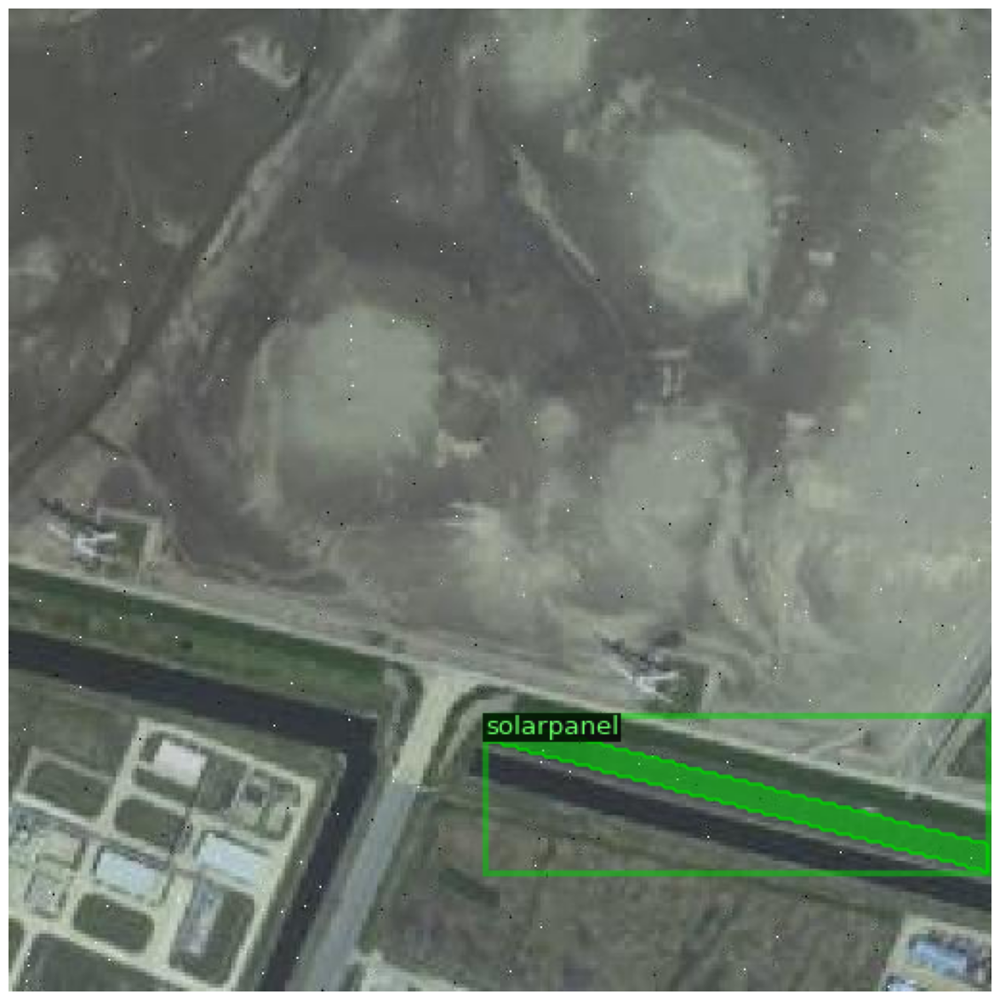

Image 1:
Number of annotations: 1
Image dimensions: (640, 640, 3)
--------------------------------------------------


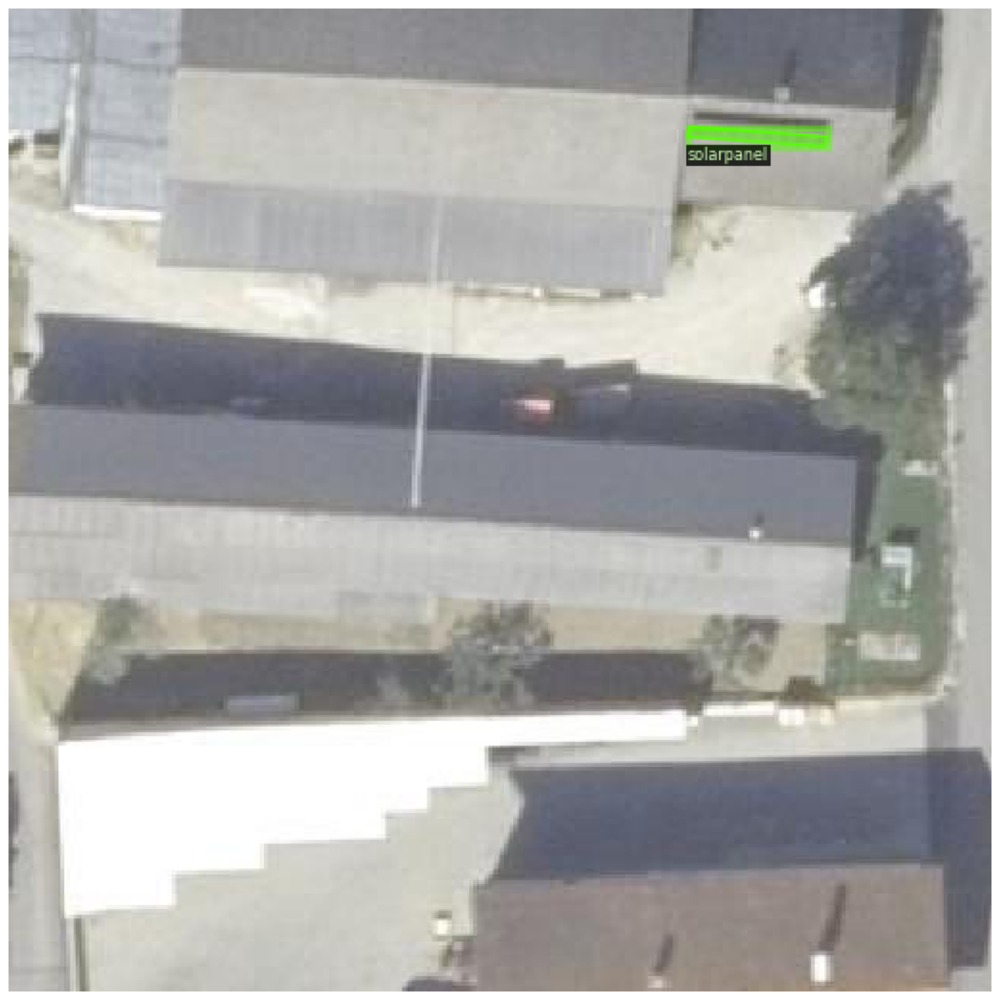

Image 2:
Number of annotations: 1
Image dimensions: (640, 640, 3)
--------------------------------------------------


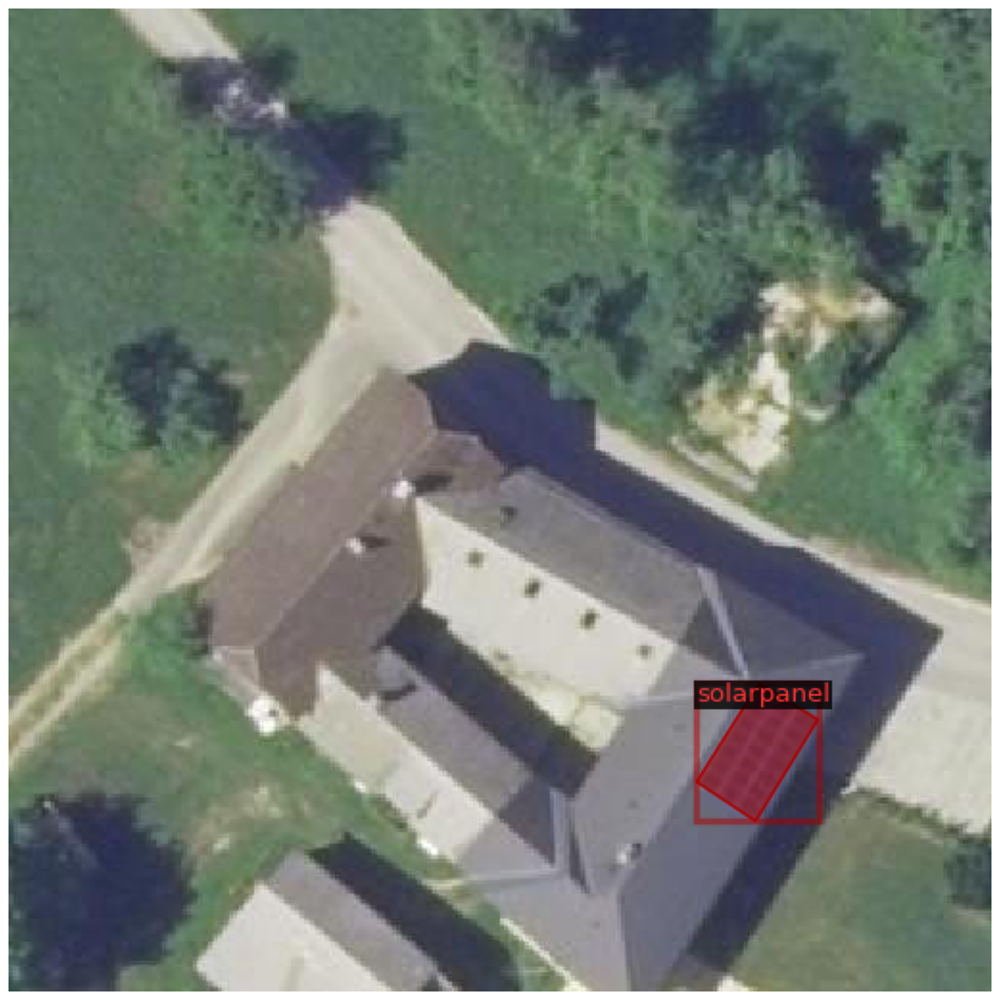

Image 3:
Number of annotations: 1
Image dimensions: (640, 640, 3)
--------------------------------------------------


In [4]:
from datetime import datetime
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import matplotlib.pyplot as plt
import cv2

def show_image(image, figsize=(15,15)):
    """
    Display image in Kaggle notebook environment
    """
    plt.figure(figsize=figsize)
    plt.imshow(image)
    plt.axis('off')
    plt.show()

# Define the dataset name correctly
TRAIN_DATA_SET_NAME = "solar_panel_train"  # This should match what we registered earlier

# Get metadata and dataset
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

# Visualize a few training images
num_samples = 3  # Change this to view more or fewer images

for i, dataset_entry in enumerate(dataset_train[:num_samples]):
    # Read the image
    image = cv2.imread(dataset_entry["file_name"])
    if image is None:
        print(f"Failed to load image: {dataset_entry['file_name']}")
        continue
        
    # Create visualizer instance
    visualizer = Visualizer(
        image[:, :, ::-1],  # BGR to RGB
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    
    # Draw the annotations
    out = visualizer.draw_dataset_dict(dataset_entry)
    
    # Display the image with annotations
    show_image(out.get_image())
    
    # Print some information about the annotations
    print(f"Image {i+1}:")
    print(f"Number of annotations: {len(dataset_entry['annotations'])}")
    print(f"Image dimensions: {image.shape}")
    print("-" * 50)

### Loading Trained Weights and Configuration

To load the trained weights and configuration, follow these steps:

 **Set Paths for Trained Weights and Configuration File**:
```python
cfg.MODEL.WEIGHTS = "path/to/your/trained_model.pth"
config_file_path = "path/to/your/config.yaml"

Feel free to adjust the paths and configurations as needed!

[02/20 03:42:22 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /kaggle/input/mrcnn-inference/pytorch/default/1/mrcnn weights and config/mrcnn.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Found 6 images
Processing: /kaggle/input/testing-images/testing imgs/4.png


/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


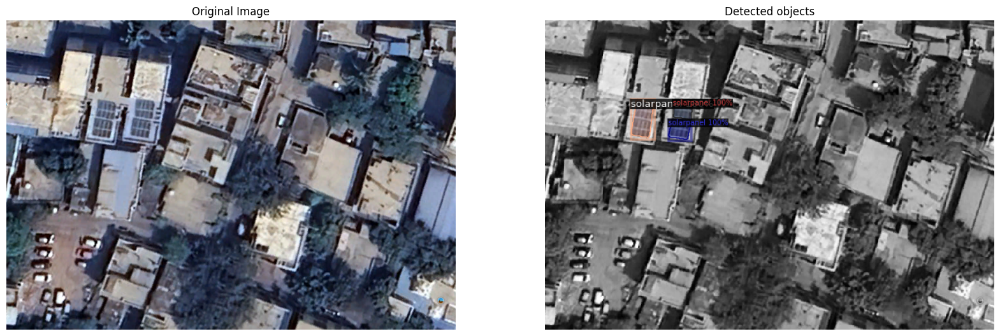

Processing: /kaggle/input/testing-images/testing imgs/1.png


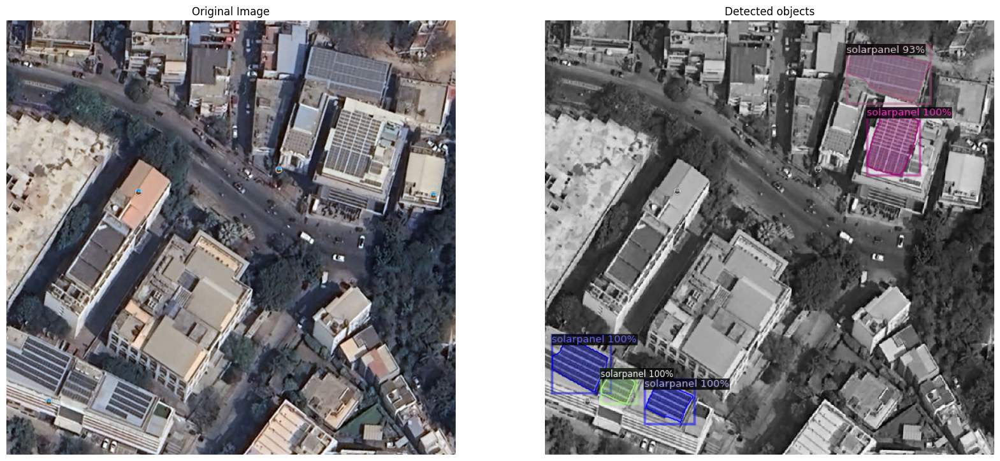

Processing: /kaggle/input/testing-images/testing imgs/2.png


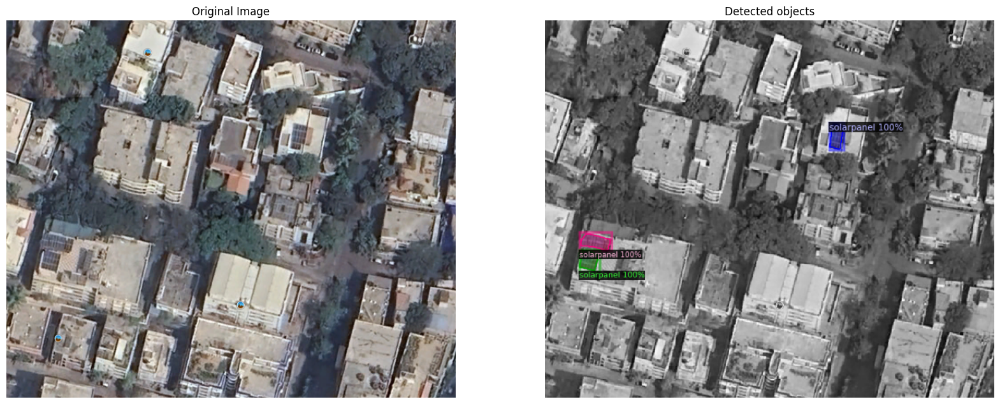

Processing: /kaggle/input/testing-images/testing imgs/5.png


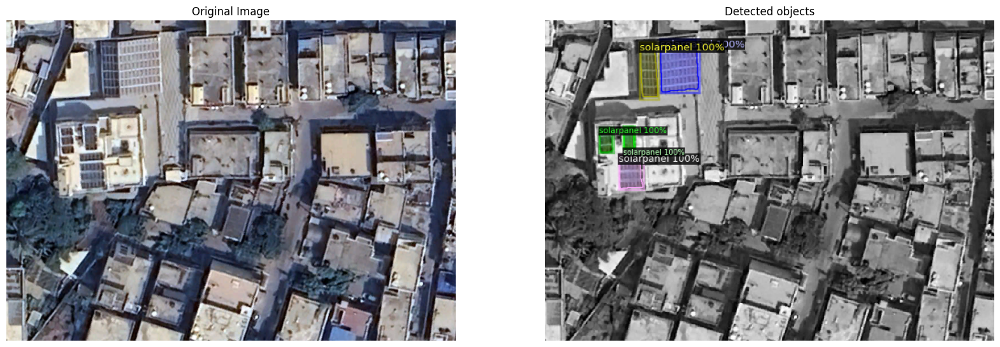

Processing: /kaggle/input/testing-images/testing imgs/3.png


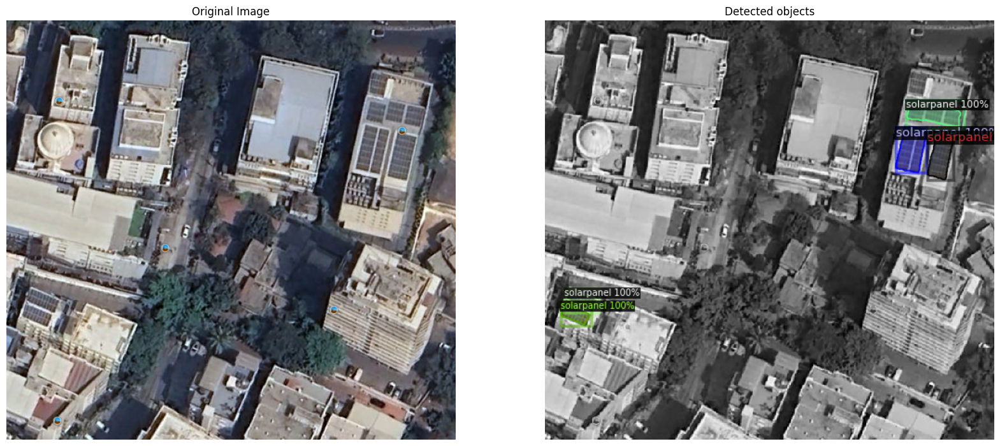

Processing: /kaggle/input/testing-images/testing imgs/6.png


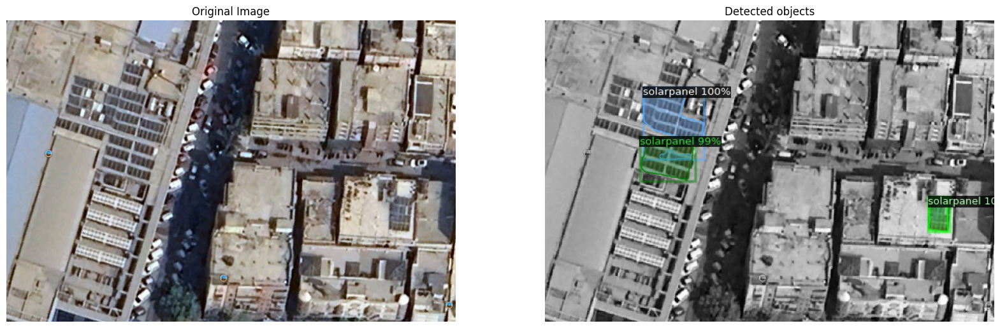

In [5]:
# First ensure predictor is properly initialized
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from datetime import datetime
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import matplotlib.pyplot as plt
import glob


# Initialize predictor if not done already
cfg = get_cfg()
cfg.merge_from_file("/kaggle/input/mrcnn-inference/pytorch/default/1/mrcnn weights and config/config.yml")  # Replace with your config path
cfg.MODEL.WEIGHTS = "/kaggle/input/mrcnn-inference/pytorch/default/1/mrcnn weights and config/mrcnn.pth"  # Replace with your model weights path
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

# Modified process_folder function to include more image formats
def process_folder(image_folder, predictor, metadata):
    # Get all images with different possible extensions
    image_paths = []
    for ext in ['*.jpg', '*.jpeg', '*.png', '*.tif', '*.tiff']:
        image_paths.extend(glob.glob(os.path.join(image_folder, ext)))
    
    print(f"Found {len(image_paths)} images")  # Debug print
    
    for image_path in image_paths:
        print(f"Processing: {image_path}")  # Debug print
        image = cv2.imread(image_path)
        
        if image is None:
            print(f"Failed to load image: {image_path}")
            continue
            
        outputs = predictor(image)
        
        v = Visualizer(image[:, :, ::-1],
                      metadata=metadata,
                      scale=0.8,
                      instance_mode=ColorMode.IMAGE_BW
        )
        predicted = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        
        plt.figure(figsize=(20,10))
        plt.subplot(1, 2, 1)
        plt.imshow(image[:, :, ::-1])
        plt.title("Original Image")
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(predicted.get_image())
        plt.title("Detected objects")
        plt.axis('off')
        
        plt.show()

# Usage with absolute path
image_folder = "/kaggle/input/testing-images/testing imgs" # PATH TO TESTING IMAGES FOLDER
process_folder(image_folder, predictor, metadata)


Processing 6 images from /kaggle/input/testing-images/testing imgs...



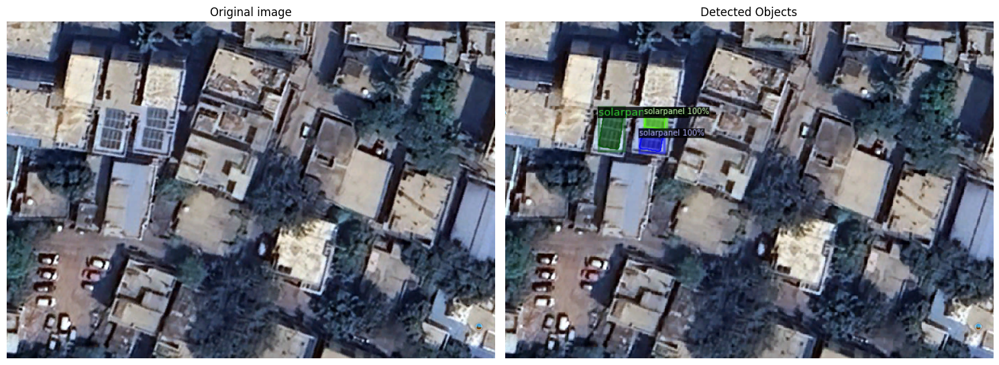

Image: 4.png
Number of detected instances: 3
--------------------------------------------------


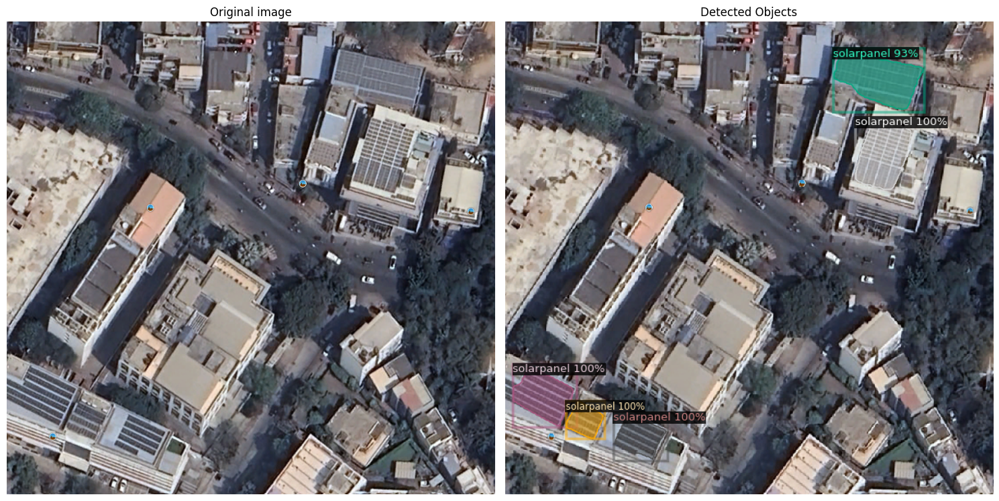

Image: 1.png
Number of detected instances: 5
--------------------------------------------------


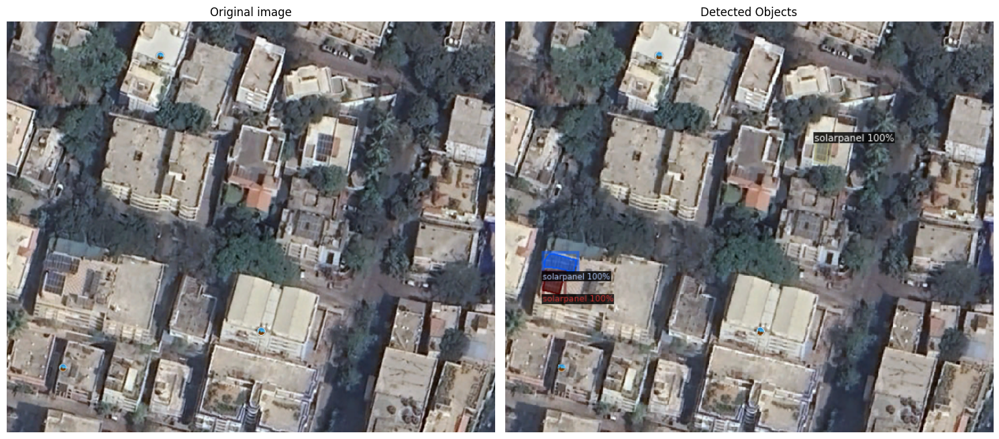

Image: 2.png
Number of detected instances: 3
--------------------------------------------------


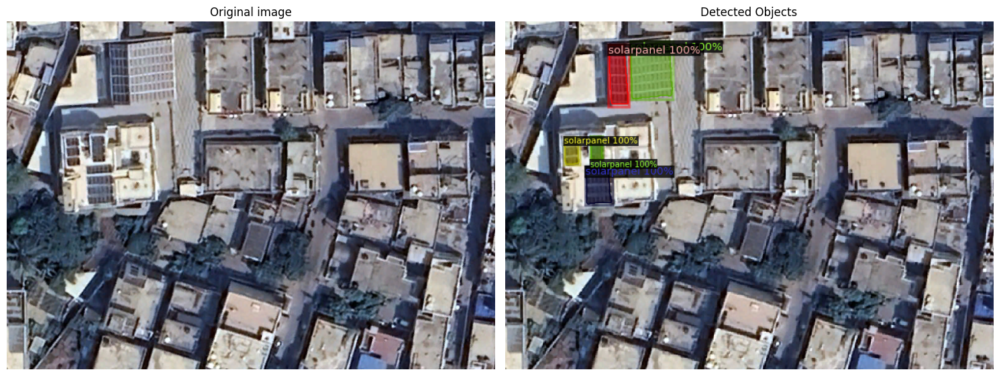

Image: 5.png
Number of detected instances: 5
--------------------------------------------------


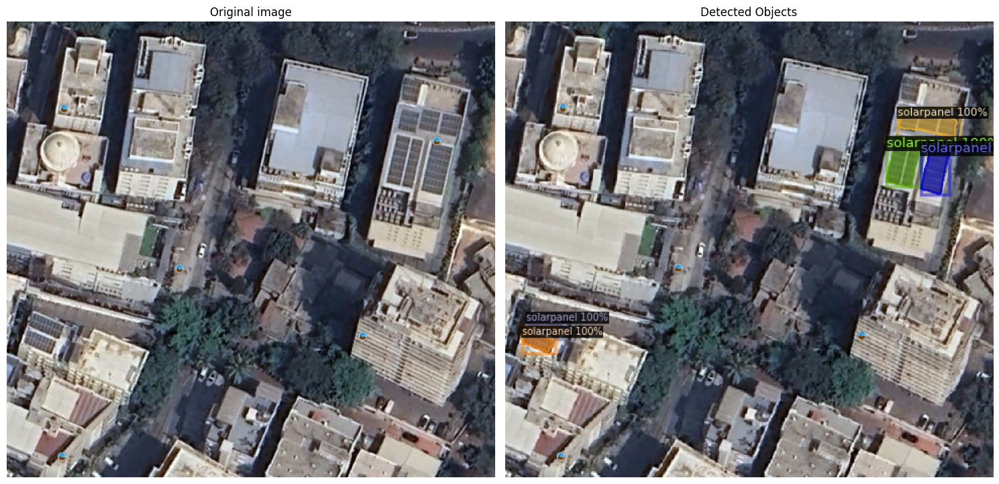

Image: 3.png
Number of detected instances: 5
--------------------------------------------------


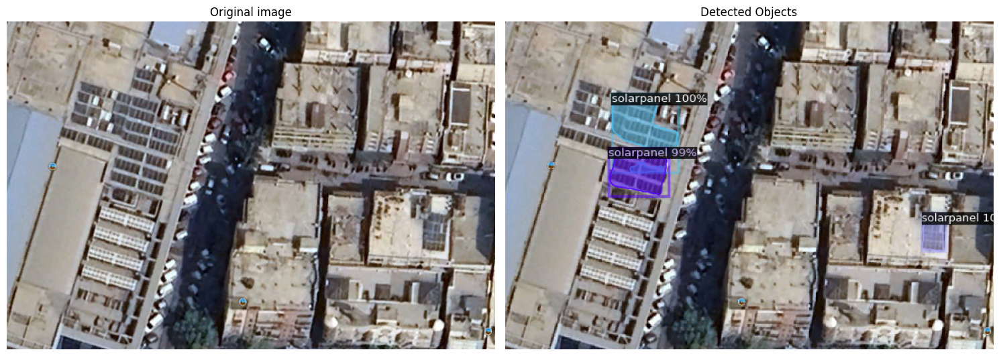

Image: 6.png
Number of detected instances: 3
--------------------------------------------------


In [6]:
import os
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer, ColorMode
import matplotlib.pyplot as plt
import cv2

def process_folder_predictions(folder_path, predictor, metadata, figsize=(15, 10)):
    """
    Process all images in a folder and display predictions.
    
    Args:
        folder_path (str): Path to folder containing images.
        predictor (Callable): Detectron2 predictor instance.
        metadata: Metadata for the dataset.
        figsize (tuple): Size of the displayed figure.
    """
    # Supported image extensions
    valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')
    
    # Get all image files from folder
    image_files = [f for f in os.listdir(folder_path) 
                   if os.path.splitext(f.lower())[1] in valid_extensions]
    
    if not image_files:
        print(f"No valid images found in {folder_path}")
        return
    
    print(f"Processing {len(image_files)} images from {folder_path}...\n")
    
    for image_file in image_files:
        # Construct full path
        image_path = os.path.join(folder_path, image_file)
        
        # Read image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Failed to read image: {image_path}")
            continue
            
        # Get predictions
        outputs = predictor(image)
        
        # Create visualization
        v = Visualizer(
            image[:, :, ::-1],  # Convert BGR to RGB
            metadata=metadata,
            scale=0.8,  # Adjust the scale if necessary
            instance_mode=ColorMode.IMAGE  # Changed from ColorMode.IMAGE_BW to ColorMode.IMAGE
        )
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        
        # Display original and prediction side by side
        plt.figure(figsize=figsize)
        
        # Original image
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original image')
        plt.axis('off')
        
        # Prediction
        plt.subplot(1, 2, 2)
        plt.imshow(out.get_image())
        plt.title('Detected Objects')
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Print number of detected instances
        num_instances = len(outputs["instances"])
        print(f"Image: {image_file}")
        print(f"Number of detected instances: {num_instances}")
        print("-" * 50)

# Get metadata
train_metadata = MetadataCatalog.get("solar_panel_train")

# Path to the folder containing test images
folder_path = "/kaggle/input/testing-images/testing imgs"# PATH TO TESTING IMAGES FOLDER

# Call the function to process images and display predictions
process_folder_predictions(folder_path, predictor, train_metadata)